<a href="https://colab.research.google.com/github/Tapiwa-Zvomuya/Manufacturing-Defect-Prediction-ML-model/blob/main/Unsupervised_Learning_Manufacturing_Defects_Project_Zvomuya.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

<img src ='https://i.pinimg.com/736x/b6/47/bf/b647bf703edb9001cce2f2ec37b8b5a1.jpg' width=400>

In [ ]:
!pip install kagglehub

# Getting the Data

In [ ]:
url='/content/manufacturing_defect_dataset.csv'

In [ ]:
import pandas as pd # Tabular data/ Data Frames
import numpy as np  # Mathematical calculations/ Arrays
import matplotlib.pyplot as plt  # Plot-Customize charts
import seaborn as sns # Advanced Visualizations
import warnings
warnings.filterwarnings("ignore")

In [ ]:
pd.read_csv(url)

,ProductionVolume,ProductionCost,SupplierQuality,DeliveryDelay,DefectRate,QualityScore,MaintenanceHours,DowntimePercentage,InventoryTurnover,StockoutRate,WorkerProductivity,SafetyIncidents,EnergyConsumption,EnergyEfficiency,AdditiveProcessTime,AdditiveMaterialCost,DefectStatus
0,202,13175.403783,86.648534,1,3.121492,63.463494,9,0.052343,8.630515,0.081322,85.042379,0,2419.616785,0.468947,5.551639,236.439301,1
1,535,19770.046093,86.310664,4,0.819531,83.697818,20,4.908328,9.296598,0.038486,99.657443,7,3915.566713,0.119485,9.080754,353.957631,1
2,960,19060.820997,82.132472,0,4.514504,90.350550,1,2.464923,5.097486,0.002887,92.819264,2,3392.385362,0.496392,6.562827,396.189402,1
3,370,5647.606037,87.335966,5,0.638524,67.628690,8,4.692476,3.577616,0.055331,96.887013,8,4652.400275,0.183125,8.097496,164.135870,1
4,206,7472.222236,81.989893,3,3.867784,82.728334,9,2.746726,6.851709,0.068047,88.315554,7,1581.630332,0.263507,6.406154,365.708964,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
3235,762,11325.689263,89.252385,2,2.667570,87.141681,16,0.987719,3.574419,0.065727,95.917264,3,3288.043242,0.420186,4.733399,299.829577,0
3236,335,5598.837988,95.701437,4,0.751272,95.562997,11,0.178163,8.295295,0.097698,87.780846,8,2761.301593,0.126441,7.234421,245.524560,0
3237,835,11736.177712,96.431554,5,4.899756,77.973442,0,4.873429,3.844824,0.005724,81.590143,5,2000.621648,0.325530,5.436538,206.490010,1
3238,302,13664.196210,91.089782,1,4.057665,95.755591,6,0.071663,2.783298,0.042612,88.488525,6,1534.792169,0.222736,3.776924,203.771655,0


In [ ]:
df=pd.read_csv(url)
df.head()

,ProductionVolume,ProductionCost,SupplierQuality,DeliveryDelay,DefectRate,QualityScore,MaintenanceHours,DowntimePercentage,InventoryTurnover,StockoutRate,WorkerProductivity,SafetyIncidents,EnergyConsumption,EnergyEfficiency,AdditiveProcessTime,AdditiveMaterialCost,DefectStatus
0,202,13175.403783,86.648534,1,3.121492,63.463494,9,0.052343,8.630515,0.081322,85.042379,0,2419.616785,0.468947,5.551639,236.439301,1
1,535,19770.046093,86.310664,4,0.819531,83.697818,20,4.908328,9.296598,0.038486,99.657443,7,3915.566713,0.119485,9.080754,353.957631,1
2,960,19060.820997,82.132472,0,4.514504,90.350550,1,2.464923,5.097486,0.002887,92.819264,2,3392.385362,0.496392,6.562827,396.189402,1
3,370,5647.606037,87.335966,5,0.638524,67.628690,8,4.692476,3.577616,0.055331,96.887013,8,4652.400275,0.183125,8.097496,164.135870,1
4,206,7472.222236,81.989893,3,3.867784,82.728334,9,2.746726,6.851709,0.068047,88.315554,7,1581.630332,0.263507,6.406154,365.708964,1


In [ ]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 3240 entries, 0 to 3239
Data columns (total 17 columns):
 #   Column                Non-Null Count  Dtype  
---  ------                --------------  -----  
 0   ProductionVolume      3240 non-null   int64  
 1   ProductionCost        3240 non-null   float64
 2   SupplierQuality       3240 non-null   float64
 3   DeliveryDelay         3240 non-null   int64  
 4   DefectRate            3240 non-null   float64
 5   QualityScore          3240 non-null   float64
 6   MaintenanceHours      3240 non-null   int64  
 7   DowntimePercentage    3240 non-null   float64
 8   InventoryTurnover     3240 non-null   float64
 9   StockoutRate          3240 non-null   float64
 10  WorkerProductivity    3240 non-null   float64
 11  SafetyIncidents       3240 non-null   int64  
 12  EnergyConsumption     3240 non-null   float64
 13  EnergyEfficiency      3240 non-null   float64
 14  AdditiveProcessTime   3240 non-null   float64
 15  AdditiveMaterialCost 

In [ ]:
df.shape

(3240, 17)

In [ ]:
df.describe()

,ProductionVolume,ProductionCost,SupplierQuality,DeliveryDelay,DefectRate,QualityScore,MaintenanceHours,DowntimePercentage,InventoryTurnover,StockoutRate,WorkerProductivity,SafetyIncidents,EnergyConsumption,EnergyEfficiency,AdditiveProcessTime,AdditiveMaterialCost,DefectStatus
count,3240.000000,3240.000000,3240.000000,3240.000000,3240.000000,3240.000000,3240.000000,3240.000000,3240.000000,3240.000000,3240.000000,3240.000000,3240.000000,3240.000000,3240.000000,3240.000000,3240.000000
mean,548.523148,12423.018476,89.833290,2.558951,2.749116,80.134272,11.476543,2.501373,6.019662,0.050878,90.040115,4.591667,2988.494453,0.299776,5.472098,299.515479,0.840432
std,262.402073,4308.051904,5.759143,1.705804,1.310154,11.611750,6.872684,1.443684,2.329791,0.028797,5.723600,2.896313,1153.420820,0.116400,2.598212,116.379905,0.366261
min,100.000000,5000.174521,80.004820,0.000000,0.500710,60.010098,0.000000,0.001665,2.001611,0.000002,80.004960,0.000000,1000.720156,0.100238,1.000151,100.211137,0.000000
25%,322.000000,8728.829280,84.869219,1.000000,1.598033,70.103420,5.750000,1.264597,3.983249,0.026200,85.180203,2.000000,1988.140273,0.200502,3.228507,194.922058,1.000000
50%,549.000000,12405.204656,89.704861,3.000000,2.708775,80.265312,12.000000,2.465151,6.022389,0.051837,90.125743,5.000000,2996.822301,0.297470,5.437134,299.728918,1.000000
75%,775.250000,16124.462428,94.789936,4.000000,3.904533,90.353822,17.000000,3.774861,8.050222,0.075473,95.050838,7.000000,3984.788299,0.402659,7.741006,403.178283,1.000000
max,999.000000,19993.365549,99.989214,5.000000,4.998529,99.996993,23.000000,4.997591,9.998577,0.099997,99.996786,9.000000,4997.074741,0.499500,9.999749,499.982782,1.000000


In [ ]:
df.isnull().sum()

,0
ProductionVolume,0
ProductionCost,0
SupplierQuality,0
DeliveryDelay,0
DefectRate,0
QualityScore,0
MaintenanceHours,0
DowntimePercentage,0
InventoryTurnover,0
StockoutRate,0


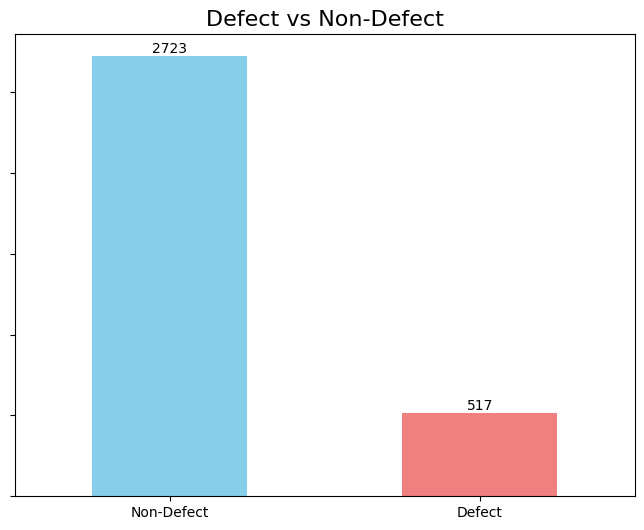

In [ ]:
fig, ax = plt.subplots(figsize=(8, 6))

count = df["DefectStatus"].value_counts()

count.plot(kind="bar", ax=ax, color=['skyblue', 'lightcoral'])
ax.set_title("Defect vs Non-Defect", fontsize=16)
ax.set_xticklabels(["Non-Defect", "Defect"], rotation=0)  # Label x-axis

for container in ax.containers:
    ax.bar_label(container)
ax.set_yticklabels(())
ax.set_ylabel("")
ax.set_xlabel("")

plt.show()

[]

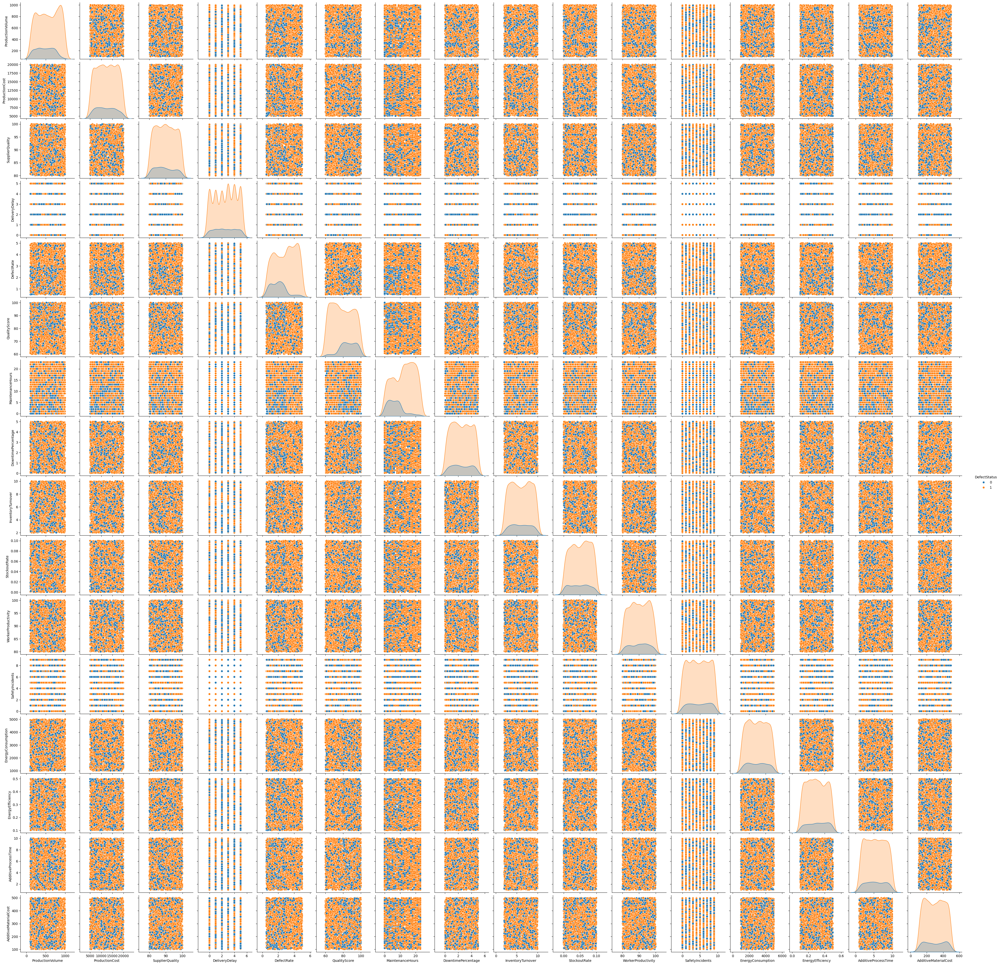

In [ ]:
sns.pairplot(data=df, hue='DefectStatus')
plt.plot()


In [ ]:
correlation_matrix = df.corr()*100

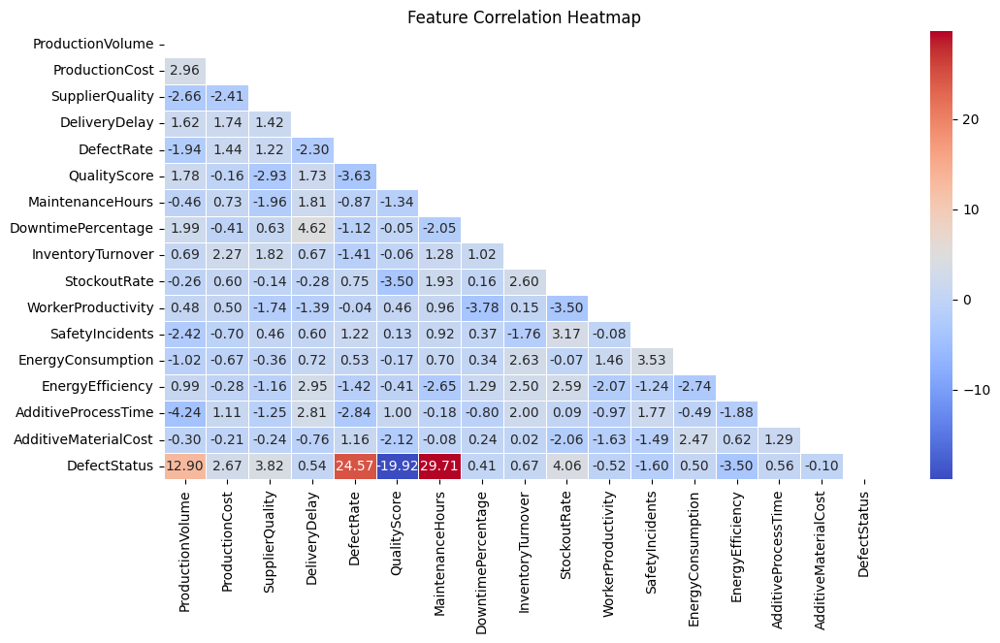

In [ ]:
#Correlation heatmap
fig, axs = plt.subplots(figsize=(12, 6))
mask = np.triu(np.ones_like(correlation_matrix, dtype=bool))
sns.heatmap(correlation_matrix, annot=True, cmap='coolwarm', fmt='.2f', linewidths=0.5, mask=mask )
plt.title('Feature Correlation Heatmap')
plt.show()

In [ ]:
# Separating defective and non-defective records
df_defective = df[df['DefectStatus'] == 1].copy()
df_non_defective = df[df['DefectStatus'] == 0].copy()

In [ ]:
# Dropping the DefectStatus so that its not part of the features
df_defective_features = df_defective.drop(columns=['DefectStatus'])
df_non_defective_features = df_non_defective.drop(columns=['DefectStatus'])

In [ ]:
from sklearn.preprocessing import StandardScaler

scaler = StandardScaler()
X_defective_scaled = scaler.fit_transform(df_defective_features)
X_non_defective_scaled = scaler.fit_transform(df_non_defective_features)


In [ ]:
#Scaling
from sklearn.cluster import KMeans

sns.set(style="ticks")
def plot_elbow_method(X_scaled, title):
    inertias = []
    k_range = range(1, 11)

    for k in k_range:
        kmeans = KMeans(n_clusters=k, random_state=42)
        kmeans.fit(X_scaled)
        inertias.append(kmeans.inertia_)

    # Elbow Curve
    plt.figure(figsize=(10, 5))
    plt.plot(k_range, inertias, marker='o')
    plt.title(f'Elbow Method for Optimal k ({title})')
    plt.xlabel('Number of clusters (k)')
    plt.ylabel('Inertia')
    plt.xticks(k_range)
    plt.show()


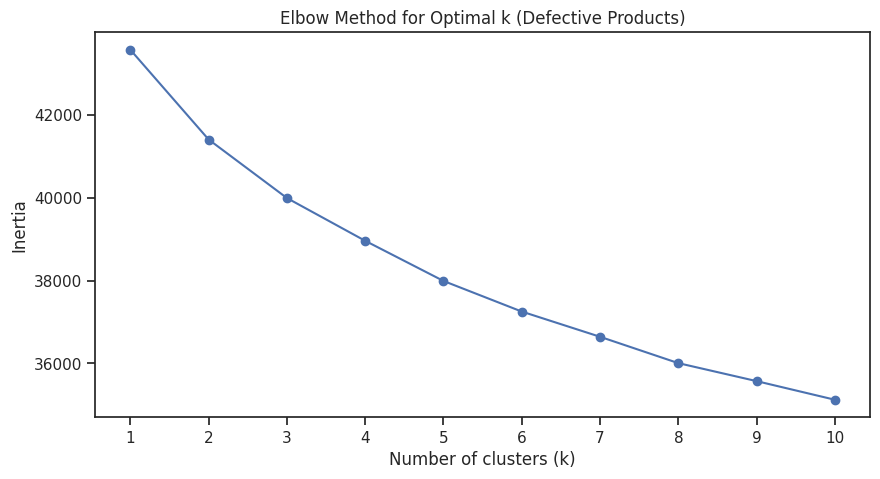

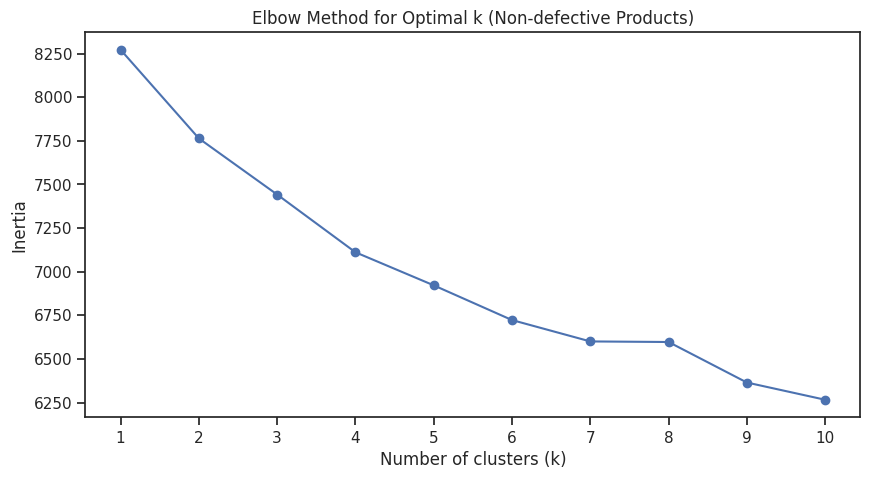

In [ ]:
plot_elbow_method(X_defective_scaled, "Defective Products")
plot_elbow_method(X_non_defective_scaled, "Non-defective Products")


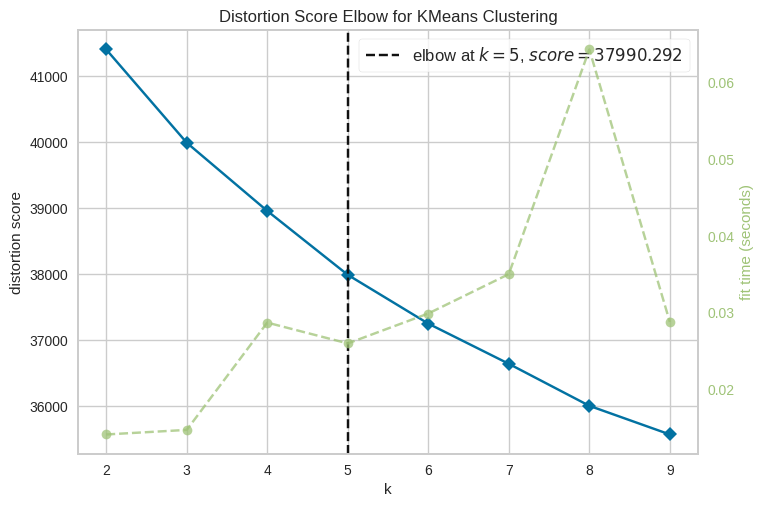

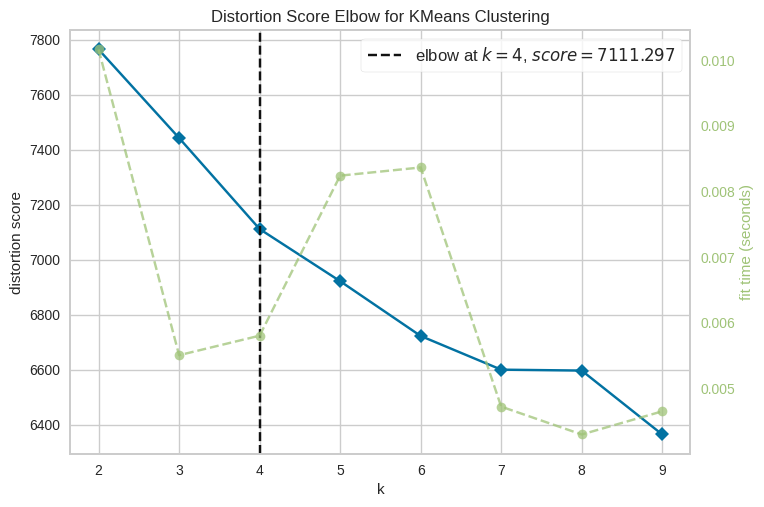

In [ ]:
from yellowbrick.cluster import KElbowVisualizer
from sklearn.cluster import KMeans


def elbow_plot_yellowbrick(X_scaled, title=""):
    model = KMeans(random_state=42)
    visualizer = KElbowVisualizer(model, k=(2, 10), metric='distortion', timings=True)
    visualizer.fit(X_scaled)
    visualizer.show(title=title)


# Elbow plot for defective products
elbow_plot_yellowbrick(X_defective_scaled, title="Elbow Method for Defective Products (Distortion Score)")

# Elbow plot for non-defective products
elbow_plot_yellowbrick(X_non_defective_scaled, title="Elbow Method for Non-Defective Products (Distortion Score)")

In [ ]:
# Fit KMeans with chosen k
kmeans_def = KMeans(n_clusters=3, random_state=42)
kmeans_def.fit(X_defective_scaled)

kmeans_nondef = KMeans(n_clusters=2, random_state=42)
kmeans_nondef.fit(X_non_defective_scaled)

# Access inertia
print("Inertia (Defective):", kmeans_def.inertia_)
print("Inertia (Non-Defective):", kmeans_nondef.inertia_)


Inertia (Defective): 39990.66935866801
Inertia (Non-Defective): 7763.806926641781


In [ ]:
df_defective['Cluster'] = kmeans_def.labels_
df_non_defective['Cluster'] = kmeans_nondef.labels_


In [ ]:
# Compare mean values for each cluster (defective products)
cluster_summary_def = df_defective.groupby('Cluster').mean(numeric_only=True)
print("Defective Clusters Summary:\n", cluster_summary_def)

# Compare mean values for each cluster (non-defective products)
cluster_summary_nondef = df_non_defective.groupby('Cluster').mean(numeric_only=True)
print("Non-Defective Clusters Summary:\n", cluster_summary_nondef)


Defective Clusters Summary:
          ProductionVolume  ProductionCost  SupplierQuality  DeliveryDelay  \
Cluster                                                                     
0              427.361635    11086.887485        90.898326       2.320755   
1              622.370044    12502.314647        88.574903       1.851322   
2              651.523810    13978.452873        90.283291       3.581882   

         DefectRate  QualityScore  MaintenanceHours  DowntimePercentage  \
Cluster                                                                   
0          3.643411     76.235775          8.771488            2.474490   
1          2.468709     83.159135         15.349119            2.094537   
2          2.497556     78.076550         13.203252            2.968416   

         InventoryTurnover  StockoutRate  WorkerProductivity  SafetyIncidents  \
Cluster                                                                         
0                 5.412551      0.053355       

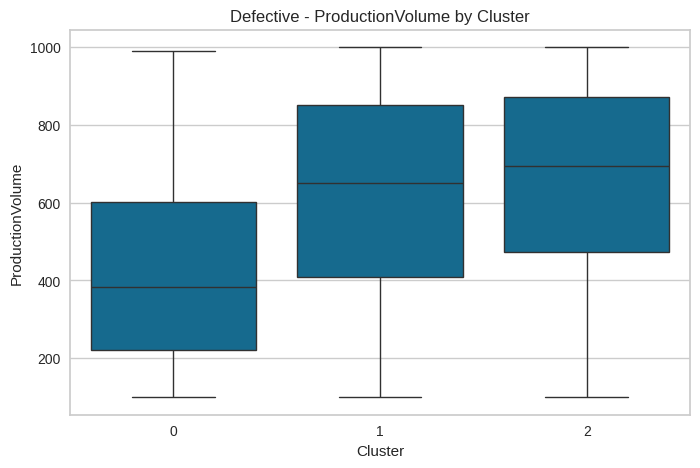

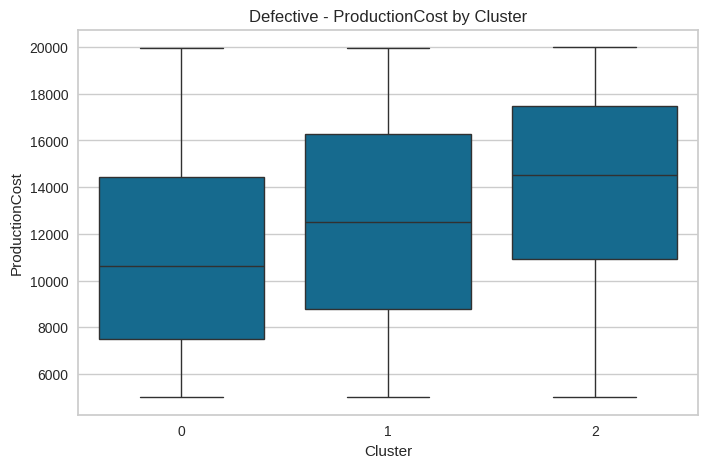

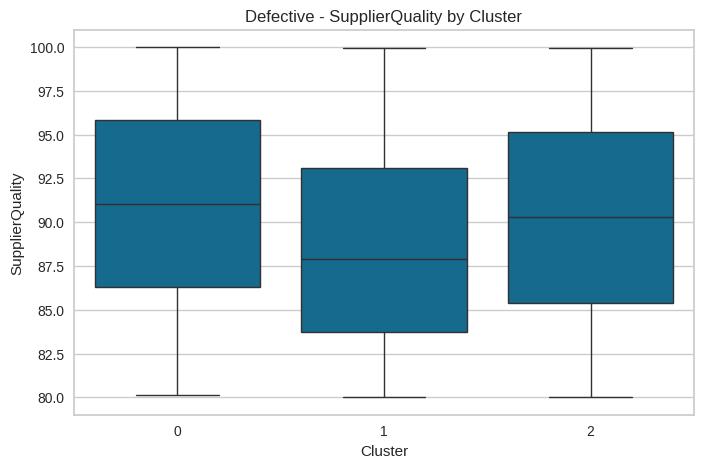

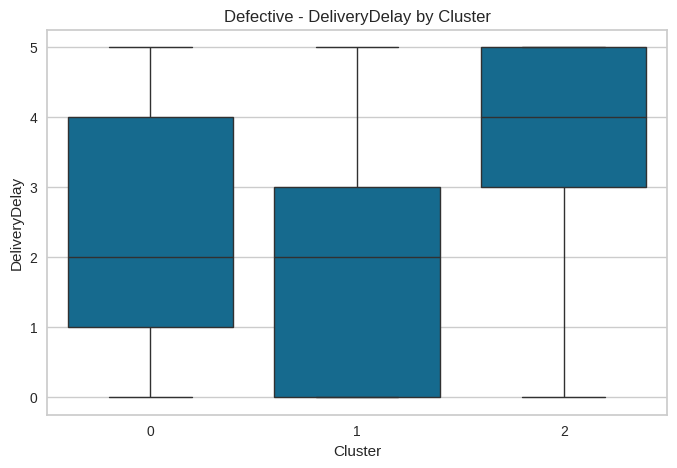

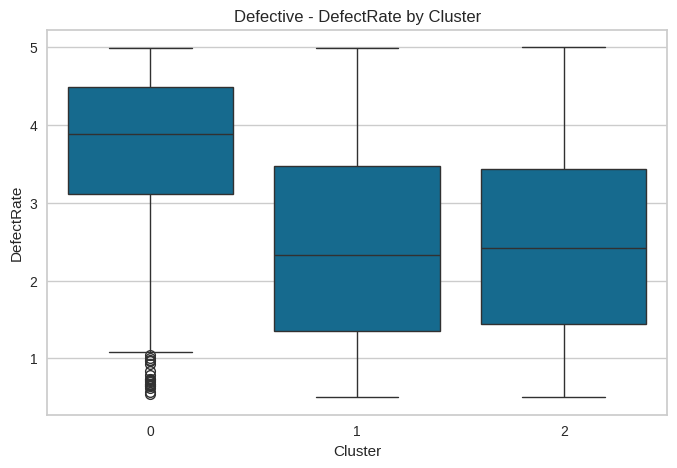

...

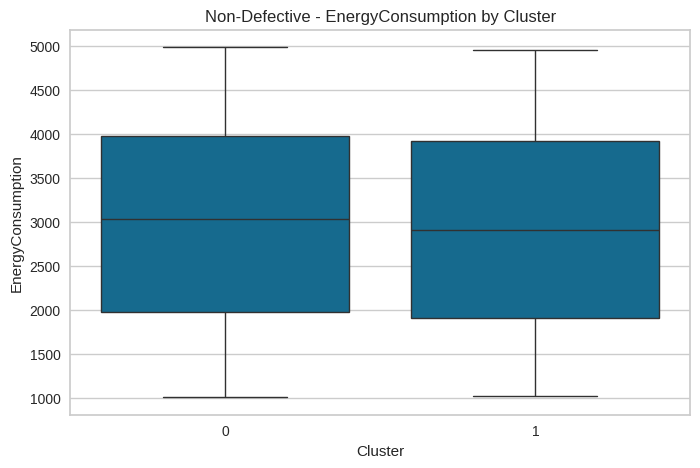

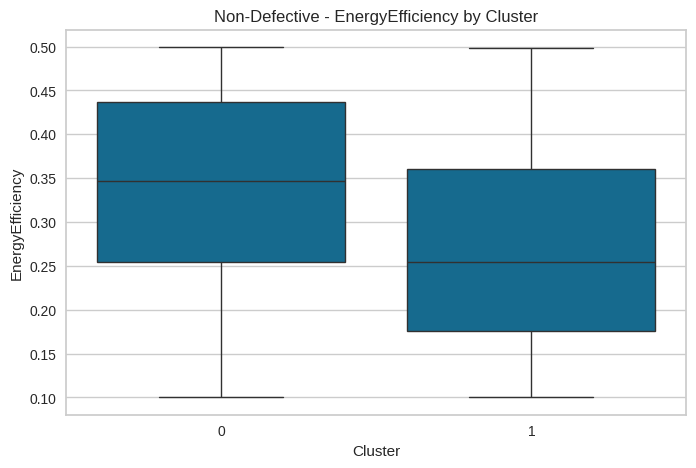

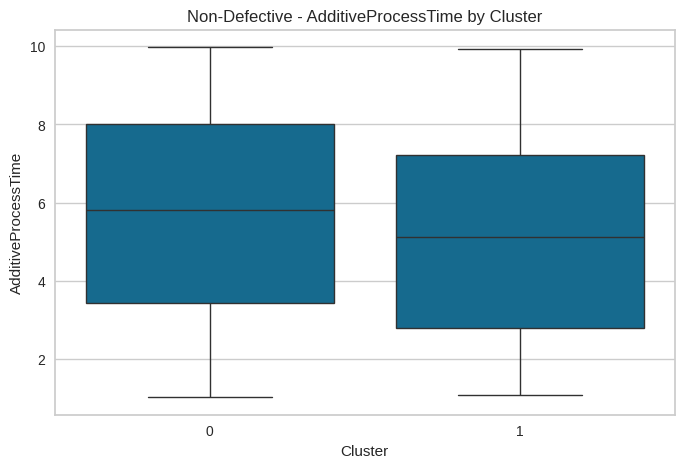

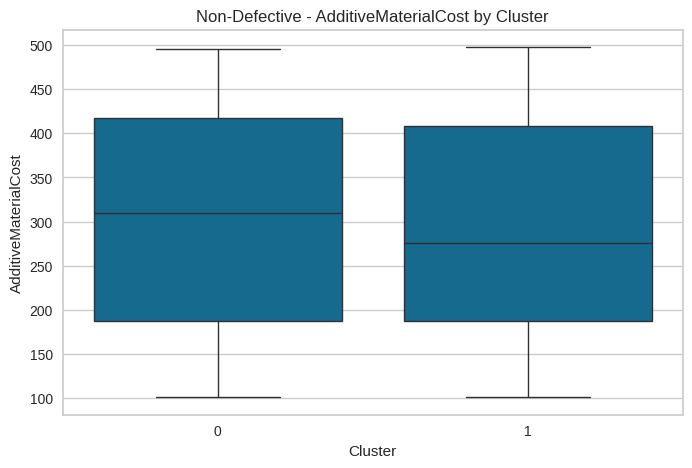

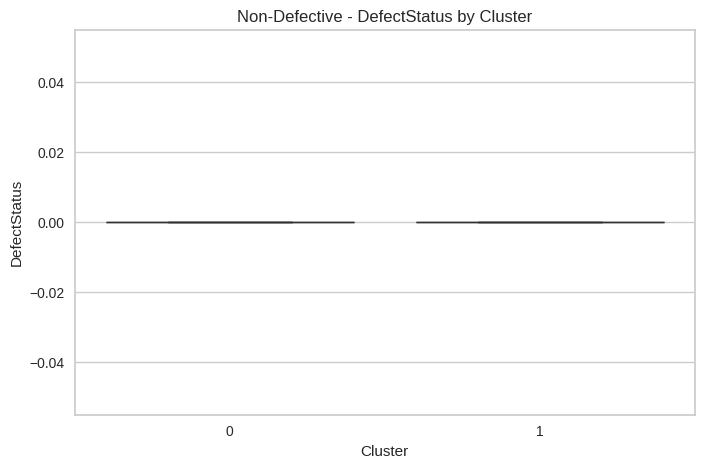

In [ ]:
# Boxplots to further analyze these features
def plot_cluster_boxplots(df, cluster_col='Cluster', title_prefix=""):
    features = [col for col in df.columns if col != cluster_col]
    for feature in features:
        plt.figure(figsize=(8, 5))
        sns.boxplot(x=cluster_col, y=feature, data=df)
        plt.title(f'{title_prefix} - {feature} by Cluster')
        plt.show()

# Boxplots for defective clusters
plot_cluster_boxplots(df_defective, title_prefix="Defective")

# Boxplots for non-defective clusters
plot_cluster_boxplots(df_non_defective, title_prefix="Non-Defective")

In [ ]:
def plot_radar_chart(cluster_summary, title):
    # Features
    labels = cluster_summary.columns.tolist()
    num_vars = len(labels)

    # Set up angles for radar chart
    angles = np.linspace(0, 2 * np.pi, num_vars, endpoint=False).tolist()
    angles += angles[:1]  # Complete the loop

    # Set up figure
    fig, ax = plt.subplots(figsize=(8, 8), subplot_kw=dict(polar=True))

    # Plot each cluster
    for i, row in cluster_summary.iterrows():
        values = row.tolist()
        values += values[:1]  # Complete the loop
        ax.plot(angles, values, label=f'Cluster {i}')
        ax.fill(angles, values, alpha=0.25)

    # Configure chart
    ax.set_title(title, size=16, y=1.1)
    ax.set_theta_offset(np.pi / 2)
    ax.set_theta_direction(-1)

    # Set axes and labels
    ax.set_thetagrids(np.degrees(angles[:-1]), labels)
    ax.legend(loc='upper right', bbox_to_anchor=(1.3, 1.1))

    plt.show()


In [ ]:
cluster_summary_def = df_defective.groupby('Cluster').mean(numeric_only=True)
cluster_summary_nondef = df_non_defective.groupby('Cluster').mean(numeric_only=True)


In [ ]:
from sklearn.preprocessing import MinMaxScaler

def normalize_df(df):
    scaler = MinMaxScaler()
    return pd.DataFrame(scaler.fit_transform(df), columns=df.columns, index=df.index)

# Normalize summaries for radar chart
cluster_summary_def_norm = normalize_df(cluster_summary_def)
cluster_summary_nondef_norm = normalize_df(cluster_summary_nondef)


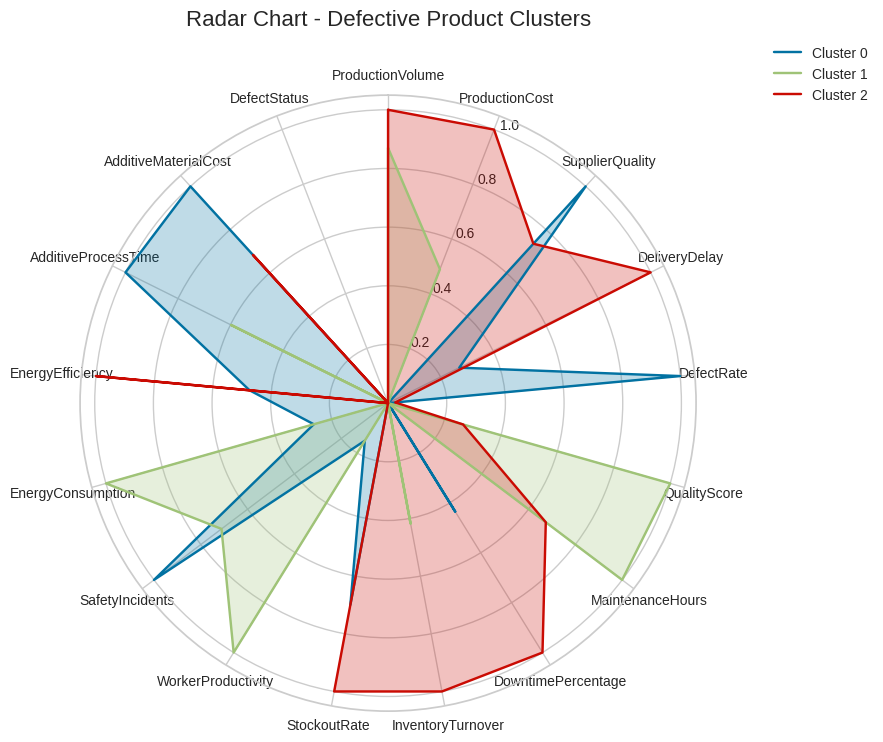

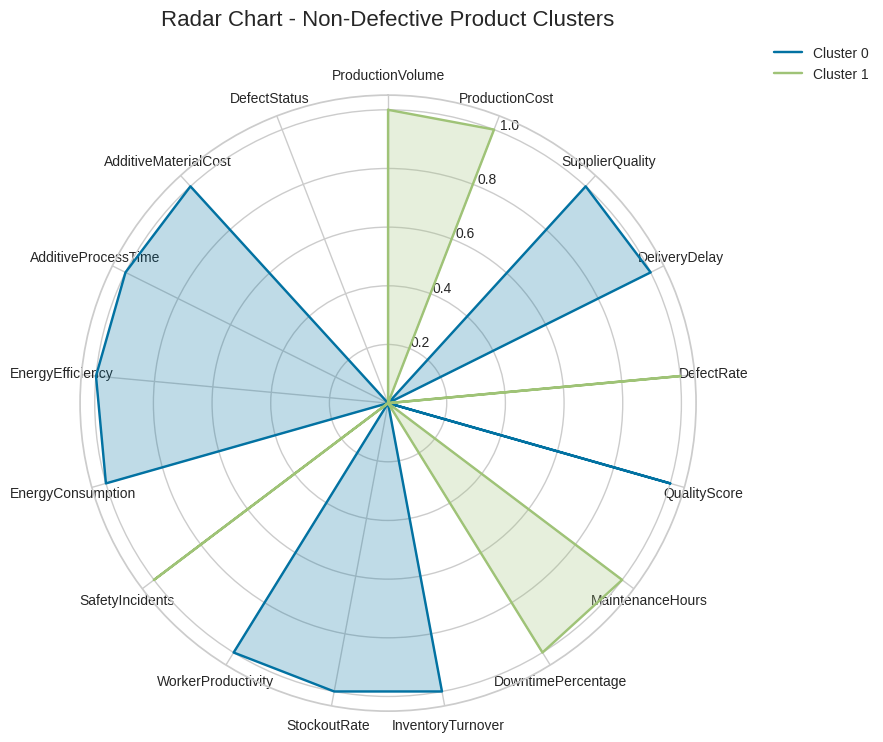

In [ ]:
plot_radar_chart(cluster_summary_def_norm, "Radar Chart - Defective Product Clusters")
plot_radar_chart(cluster_summary_nondef_norm, "Radar Chart - Non-Defective Product Clusters")


In [ ]:
import plotly.graph_objects as go # Import the plotly.graph_objects module and alias it as 'go'

def plot_interactive_radar_chart(cluster_summary, title):
    categories = cluster_summary.columns.tolist()
    fig = go.Figure()

    for i, row in cluster_summary.iterrows():
        fig.add_trace(go.Scatterpolar(
            r=row.tolist(),
            theta=categories,
            fill='toself',
            name=f'Cluster {i}'
        ))

    fig.update_layout(
        polar=dict(
            radialaxis=dict(
                visible=True,
                range=[0, 1.5]
            )
        ),
        showlegend=True,
        title=title
    )

    fig.show()

# Example usage:
plot_interactive_radar_chart(cluster_summary_def_norm, "Interactive Radar Chart - Defective Product Clusters")
plot_interactive_radar_chart(cluster_summary_nondef_norm, "Interactive Radar Chart - Non-Defective Product Clusters")

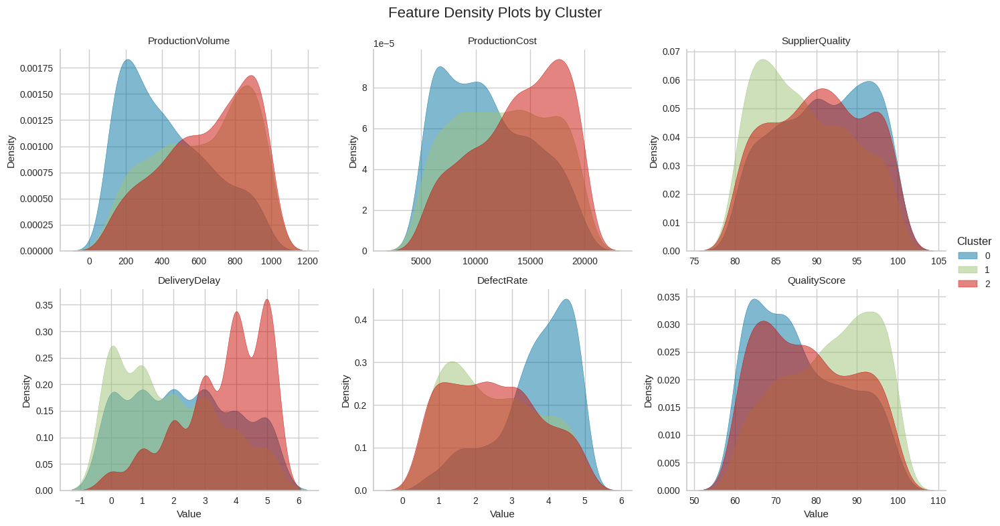

In [ ]:
# Density Plots
kmeans = kmeans_def  # Assign kmeans_def to kmeans


df_plot = df_defective_features.copy()
df_plot['cluster'] = kmeans.labels_

# Choose subset of features to visualize (you can include all if manageable)
features_to_plot = df_defective_features.columns[:6]  # Adjust number based on layout clarity

# Melt the dataframe to long format for FacetGrid
df_melted = pd.melt(df_plot, id_vars='cluster', value_vars=features_to_plot,
                    var_name='Feature', value_name='Value')

# Plot using FacetGrid
g = sns.FacetGrid(df_melted, col="Feature", col_wrap=3, hue="cluster", sharex=False, sharey=False, height=4, aspect=1.2)
g.map(sns.kdeplot, "Value", fill=True, common_norm=False, alpha=0.5)
g.add_legend(title="Cluster")
g.set_titles(col_template="{col_name}")
g.fig.subplots_adjust(top=0.9)
g.fig.suptitle("Feature Density Plots by Cluster", fontsize=16)
plt.show()

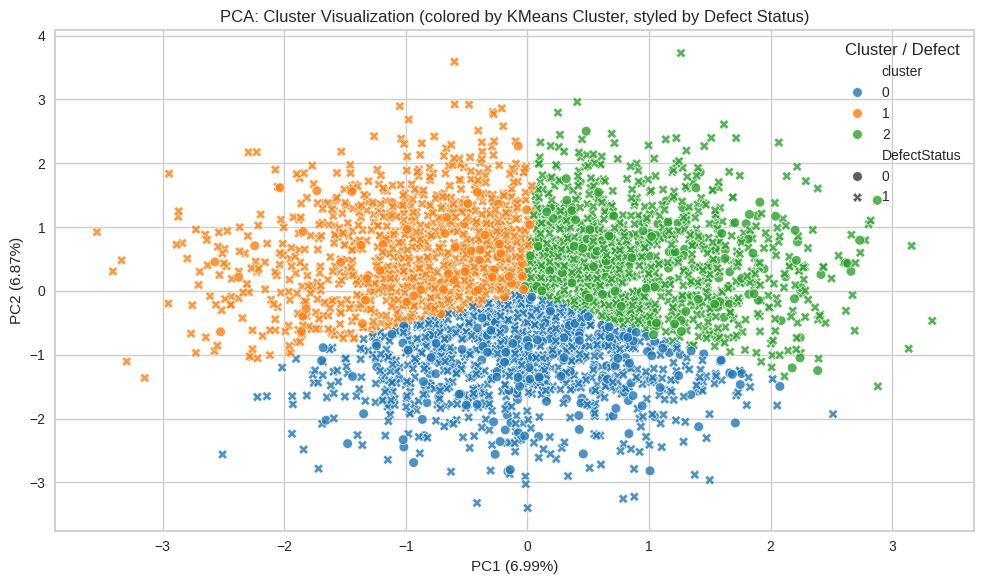

In [ ]:
from sklearn.decomposition import PCA
from sklearn.preprocessing import StandardScaler


df_features = df.drop(columns=['DefectStatus'])

# 2. Standardize the data
scaler = StandardScaler()
X_scaled = scaler.fit_transform(df_features) # Use df_features here

# 3. Apply PCA
pca = PCA(n_components=2)  # use 2 for 2D visualization
X_pca = pca.fit_transform(X_scaled)

# 4. Create a DataFrame for plotting
pca_df = pd.DataFrame(data=X_pca, columns=['PC1', 'PC2'])


kmeans_pca = KMeans(n_clusters=3, random_state=42)
kmeans_pca.fit(X_pca)  # Fit to PCA data

pca_df['cluster'] = kmeans_pca.labels_  # Assign labels from kmeans_pca

pca_df['DefectStatus'] = df['DefectStatus'].values

# 6. Plot PCA clusters
plt.figure(figsize=(10, 6))
sns.scatterplot(data=pca_df, x='PC1', y='PC2', hue='cluster', style='DefectStatus', palette='tab10', alpha=0.8)
plt.title('PCA: Cluster Visualization (colored by KMeans Cluster, styled by Defect Status)')
plt.xlabel(f'PC1 ({pca.explained_variance_ratio_[0]*100:.2f}%)')
plt.ylabel(f'PC2 ({pca.explained_variance_ratio_[1]*100:.2f}%)')
plt.legend(title='Cluster / Defect')
plt.grid(True)
plt.tight_layout()
plt.show()

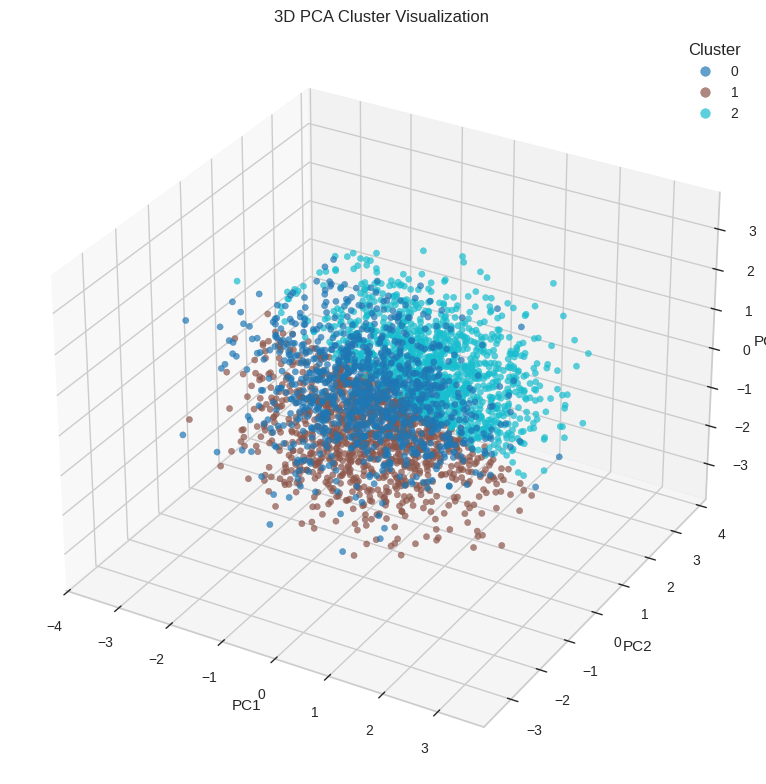

In [ ]:
from sklearn.decomposition import PCA
from sklearn.preprocessing import StandardScaler
from mpl_toolkits.mplot3d import Axes3D

# Standardize the data
scaler = StandardScaler()
X_scaled = scaler.fit_transform(df_features)

# Apply PCA with 3 components
pca_3d = PCA(n_components=3)
X_pca_3d = pca_3d.fit_transform(X_scaled)

# Create DataFrame
pca_df_3d = pd.DataFrame(X_pca_3d, columns=['PC1', 'PC2', 'PC3'])

kmeans_pca_3d = KMeans(n_clusters=3, random_state=42)  # Adjust n_clusters if needed
kmeans_pca_3d.fit(X_pca_3d)  # Fit to PCA data

pca_df_3d['cluster'] = kmeans_pca_3d.labels_  # Assign labels from kmeans_pca_3d

pca_df_3d['DefectStatus'] = df['DefectStatus'].values

# Plot 3D PCA
fig = plt.figure(figsize=(10, 8))
ax = fig.add_subplot(111, projection='3d')
scatter = ax.scatter(pca_df_3d['PC1'], pca_df_3d['PC2'], pca_df_3d['PC3'],
                     c=pca_df_3d['cluster'], cmap='tab10', alpha=0.7)

ax.set_xlabel('PC1')
ax.set_ylabel('PC2')
ax.set_zlabel('PC3')
ax.set_title('3D PCA Cluster Visualization')
plt.legend(*scatter.legend_elements(), title="Cluster")
plt.tight_layout()
plt.show()

In [ ]:
# Fit PCA with 2 components again
pca_2d = PCA(n_components=2)
X_pca_2d = pca_2d.fit_transform(X_scaled)

# Create DataFrame
pca_df_2d = pd.DataFrame(X_pca_2d, columns=['PC1', 'PC2'])

# Fit KMeans to the PCA-transformed data:
kmeans_pca_2d = KMeans(n_clusters=3, random_state=42)  # Adjust n_clusters if needed
kmeans_pca_2d.fit(X_pca_2d)  # Fit to PCA data

pca_df_2d['cluster'] = kmeans_pca_2d.labels_  # Assign labels from kmeans_pca_2d

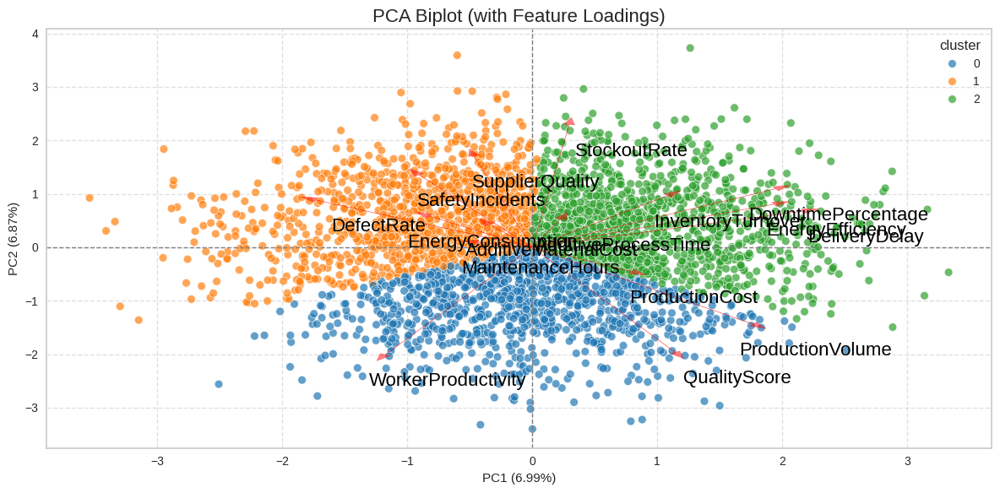

In [ ]:
# Biplot with clearer labels and scaling
plt.figure(figsize=(12, 6))
sns.scatterplot(data=pca_df_2d, x='PC1', y='PC2', hue='cluster', palette='tab10', alpha=0.7)

# Plot feature vectors with better scaling
for i, feature in enumerate(df_features.columns):
    x = pca_2d.components_[0, i]
    y = pca_2d.components_[1, i]
    plt.arrow(0, 0, x*5, y*5, color='red', alpha=0.5, head_width=0.09)
    plt.text(x*5 + 0.5, y*5 - 0.5, feature, fontsize=16, color='black', ha='center', va='center')

plt.xlabel(f'PC1 ({pca_2d.explained_variance_ratio_[0]*100:.2f}%)')
plt.ylabel(f'PC2 ({pca_2d.explained_variance_ratio_[1]*100:.2f}%)')
plt.title('PCA Biplot (with Feature Loadings)', fontsize=16)
plt.axhline(0, color='gray', linestyle='--', linewidth=1)
plt.axvline(0, color='gray', linestyle='--', linewidth=1)
plt.grid(True, linestyle='--', alpha=0.6)
plt.tight_layout()
plt.show()



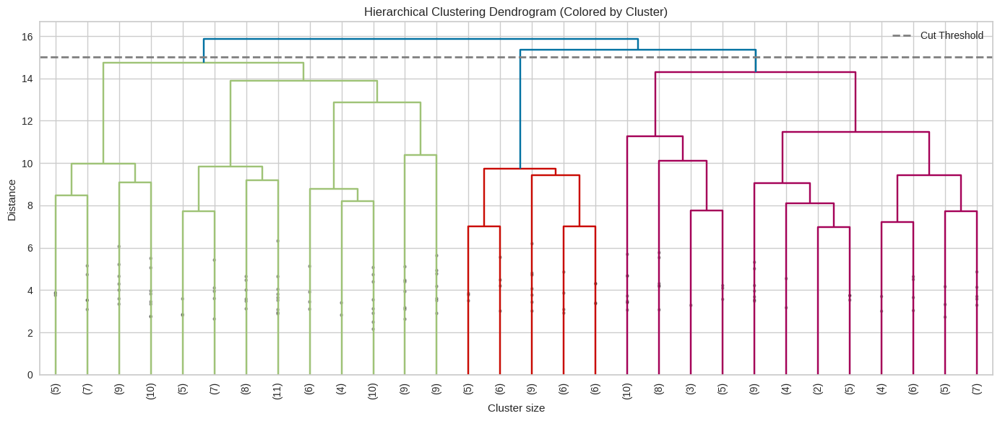

In [ ]:
from scipy.cluster.hierarchy import linkage, dendrogram, fcluster
from sklearn.preprocessing import StandardScaler
import matplotlib.pyplot as plt
import seaborn as sns
import pandas as pd

# Sample to avoid clutter (optional for large datasets)
sample_df = df_features.sample(n=200, random_state=42)
scaler = StandardScaler()
X_scaled = scaler.fit_transform(sample_df)

# Perform hierarchical clustering
linked = linkage(X_scaled, method='ward')

# Auto-determine clusters using a distance threshold
max_d = 15  # adjust this value to control cut height
clusters = fcluster(linked, t=max_d, criterion='distance')

# Add cluster labels to the sample
sample_df = sample_df.copy()
sample_df['cluster'] = clusters

# Plot dendrogram with color threshold
plt.figure(figsize=(14, 6))
dendrogram(linked,
           truncate_mode='lastp',  # can also remove this for full tree
           p=30,
           color_threshold=max_d,
           leaf_rotation=90.,
           leaf_font_size=10,
           show_contracted=True)
plt.axhline(y=max_d, c='gray', lw=2, linestyle='dashed', label='Cut Threshold')
plt.title('Hierarchical Clustering Dendrogram (Colored by Cluster)')
plt.xlabel('Cluster size')
plt.ylabel('Distance')
plt.legend()
plt.tight_layout()
plt.show()
